In [1]:
## Wherever u edit, please comment it with your name for future reference.
### If you think you have completed a milestone, please download the file and save it to your local machine for future reference. 

In [3]:
## Import File Below this block
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/602 project/aviation_data_merged.csv")

In [4]:
## Prerequisite Library
import seaborn as sns
import matplotlib.pyplot as plt
import warnings


In [5]:
df.head()

,date,hour,runway,weather,dep_eff_comp,arr_eff_comp,total_eff_comp,dep_facility_rep,arr_facility_rep,total_facility_rep,...,per_ontime_arp_dep,per_ontime_gate_arr,avg_gate_dep_delay,avg_taxi_out_time,avg_taxi_out_delay,avg_arp_dep_delay,avg_airborn_delay,avg_tax_in_dealy,avg_block_delay,avg_gate_arr_delay
0,1/1/22,0.0,22L | 22R,IMC,5,10,15,0,0,0,...,0.0,66.67,110.50,12.00,0.00,109.5,3.22,4.22,2.89,14.22
1,1/1/22,1.0,22L | 22R,IMC,2,3,5,0,0,0,...,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00
2,1/1/22,2.0,22L | 22R,IMC,0,0,0,0,0,0,...,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00
3,1/1/22,3.0,22L | 22R,IMC,1,1,2,0,0,0,...,0.0,60.00,0.00,0.00,0.00,0.0,1.00,0.98,3.60,43.80
4,1/1/22,4.0,22L | 22R,IMC,0,2,2,0,0,0,...,100.0,66.67,0.25,14.25,2.15,1.0,15.83,2.20,18.67,38.50


In [6]:
df.describe()

,hour,avg_cap,cap_utilized_percent,dep_eff,arr_eff,saer,per_ontime_gate_dep,per_ontime_arp_dep,per_ontime_gate_arr,avg_gate_dep_delay,avg_taxi_out_time,avg_taxi_out_delay,avg_arp_dep_delay,avg_airborn_delay,avg_tax_in_dealy,avg_block_delay,avg_gate_arr_delay
count,5832.00000,5833.000000,5833.000000,5833.000000,5833.000000,5833.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000,5797.000000
mean,11.50000,76.660895,58.146403,91.287833,95.594646,93.156983,61.381930,48.568106,65.664989,20.494901,20.086721,8.944042,28.082914,3.337699,6.216476,5.597406,20.955903
std,6.92278,8.437916,29.754681,12.450909,10.136614,9.815878,30.441751,31.592384,27.231230,24.576788,10.963796,9.070444,29.757648,5.510457,5.923113,8.085037,25.191452
min,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.75000,78.000000,32.500000,87.730000,95.650000,90.910000,44.830000,21.740000,52.940000,4.970000,15.970000,3.610000,9.000000,1.000000,2.560000,1.470000,6.180000
50%,11.50000,80.000000,67.500000,95.220000,100.000000,96.150000,69.230000,51.160000,73.530000,13.890000,19.660000,7.200000,21.000000,2.400000,4.770000,3.530000,13.600000
75%,17.25000,80.000000,81.250000,100.000000,100.000000,100.000000,84.620000,74.070000,85.000000,26.980000,23.970000,11.450000,36.720000,3.920000,8.120000,6.870000,26.440000
max,23.00000,94.000000,140.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,237.000000,103.000000,90.400000,277.400000,153.040000,86.680000,157.270000,354.550000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5837 entries, 0 to 5836
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   date                  5832 non-null   object 
 1   hour                  5832 non-null   float64
 2   runway                5741 non-null   object 
 3   weather               5832 non-null   object 
 4   dep_eff_comp          5833 non-null   object 
 5   arr_eff_comp          5833 non-null   object 
 6   total_eff_comp        5833 non-null   object 
 7   dep_facility_rep      5833 non-null   object 
 8   arr_facility_rep      5833 non-null   object 
 9   total_facility_rep    5833 non-null   object 
 10  dep_demand_units      5833 non-null   object 
 11  arr_demand_units      5833 non-null   object 
 12  total_demand_units    5833 non-null   object 
 13  eff_aar               5833 non-null   object 
 14  adr                   5833 non-null   object 
 15  cap_aar              

In [8]:
# Avoiding null rows 
df = df.iloc[:-5,:]

In [10]:
pip install pendulum 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 155 kB 2.0 MB/s 
     |████████████████████████████████| 489 kB 22.6 MB/s 


In [11]:
import pendulum as pdl

In [12]:
date_col = df['date']+" "+df['hour'].astype(int).astype(str)

In [13]:
date_col

0         1/1/22 0
1         1/1/22 1
2         1/1/22 2
3         1/1/22 3
4         1/1/22 4
           ...    
5827    8/31/22 19
5828    8/31/22 20
5829    8/31/22 21
5830    8/31/22 22
5831    8/31/22 23
Length: 5832, dtype: object

In [14]:
test = pdl.from_format('09/13/22 08', 'MM/DD/YY HH')

In [15]:
type(test)

pendulum.datetime.DateTime

In [16]:
test.hour, test.day, test.month, test.year

(8, 13, 9, 2022)

In [17]:
## Parsing date_col to pdl.datetime format
for i in range(len(df)):
  temp = date_col[i]
  print(temp)
  temp = pdl.from_format(temp, 'MM/DD/YY HH')
  df['date'][i] = temp

1/1/22 0
1/1/22 1
1/1/22 2
1/1/22 3
1/1/22 4
1/1/22 5
1/1/22 6
1/1/22 7
1/1/22 8
1/1/22 9
1/1/22 10
1/1/22 11
1/1/22 12
1/1/22 13
1/1/22 14
1/1/22 15
1/1/22 16
1/1/22 17
1/1/22 18
1/1/22 19
1/1/22 20
1/1/22 21
1/1/22 22
1/1/22 23
1/2/22 0
1/2/22 1
1/2/22 2
1/2/22 3
1/2/22 4
1/2/22 5
1/2/22 6
1/2/22 7
1/2/22 8
1/2/22 9
1/2/22 10
1/2/22 11
1/2/22 12
1/2/22 13
1/2/22 14
1/2/22 15
1/2/22 16
1/2/22 17
1/2/22 18
1/2/22 19
1/2/22 20
1/2/22 21
1/2/22 22
1/2/22 23
1/3/22 0
1/3/22 1
1/3/22 2
1/3/22 3
1/3/22 4
1/3/22 5
1/3/22 6
1/3/22 7
1/3/22 8
1/3/22 9
1/3/22 10
1/3/22 11
1/3/22 12
1/3/22 13
1/3/22 14
1/3/22 15
1/3/22 16
1/3/22 17
1/3/22 18
1/3/22 19
1/3/22 20
1/3/22 21
1/3/22 22
1/3/22 23
1/4/22 0
1/4/22 1
1/4/22 2
1/4/22 3
1/4/22 4
1/4/22 5
1/4/22 6
1/4/22 7
1/4/22 8
1/4/22 9
1/4/22 10
1/4/22 11
1/4/22 12
1/4/22 13
1/4/22 14
1/4/22 15
1/4/22 16
1/4/22 17
1/4/22 18
1/4/22 19
1/4/22 20
1/4/22 21
1/4/22 22
1/4/22 23
1/5/22 0
1/5/22 1
1/5/22 2
1/5/22 3
1/5/22 4
1/5/22 5
1/5/22 6
1/5/22 7
1/5/22 8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Streaming output truncated to the last 5000 lines.
2/4/22 16
2/4/22 17
2/4/22 18
2/4/22 19
2/4/22 20
2/4/22 21
2/4/22 22
2/4/22 23
2/5/22 0
2/5/22 1
2/5/22 2
2/5/22 3
2/5/22 4
2/5/22 5
2/5/22 6
2/5/22 7
2/5/22 8
2/5/22 9
2/5/22 10
2/5/22 11
2/5/22 12
2/5/22 13
2/5/22 14
2/5/22 15
2/5/22 16
2/5/22 17
2/5/22 18
2/5/22 19
2/5/22 20
2/5/22 21
2/5/22 22
2/5/22 23
2/6/22 0
2/6/22 1
2/6/22 2
2/6/22 3
2/6/22 4
2/6/22 5
2/6/22 6
2/6/22 7
2/6/22 8
2/6/22 9
2/6/22 10
2/6/22 11
2/6/22 12
2/6/22 13
2/6/22 14
2/6/22 15
2/6/22 16
2/6/22 17
2/6/22 18
2/6/22 19
2/6/22 20
2/6/22 21
2/6/22 22
2/6/22 23
2/7/22 0
2/7/22 1
2/7/22 2
2/7/22 3
2/7/22 4
2/7/22 5
2/7/22 6
2/7/22 7
2/7/22 8
2/7/22 9
2/7/22 10
2/7/22 11
2/7/22 12
2/7/22 13
2/7/22 14
2/7/22 15
2/7/22 16
2/7/22 17
2/7/22 18
2/7/22 19
2/7/22 20
2/7/22 21
2/7/22 22
2/7/22 23
2/8/22 0
2/8/22 1
2/8/22 2
2/8/22 3
2/8/22 4
2/8/22 5
2/8/22 6
2/8/22 7
2/8/22 8
2/8/22 9
2/8/22 10
2/8/22 11
2/8/22 12
2/8/22 13
2/8/22 14
2/8/22 15
2/8/22 16
2/8/22 17
2/8/22 18

In [18]:
# Reindexing the df with newly converted datetime format column
df.index = df['date']

In [19]:
df.head()

,date,hour,runway,weather,dep_eff_comp,arr_eff_comp,total_eff_comp,dep_facility_rep,arr_facility_rep,total_facility_rep,...,per_ontime_arp_dep,per_ontime_gate_arr,avg_gate_dep_delay,avg_taxi_out_time,avg_taxi_out_delay,avg_arp_dep_delay,avg_airborn_delay,avg_tax_in_dealy,avg_block_delay,avg_gate_arr_delay
date,,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00+00:00,2022-01-01T00:00:00+00:00,0.0,22L | 22R,IMC,5,10,15,0,0,0,...,0.0,66.67,110.50,12.00,0.00,109.5,3.22,4.22,2.89,14.22
2022-01-01 01:00:00+00:00,2022-01-01T01:00:00+00:00,1.0,22L | 22R,IMC,2,3,5,0,0,0,...,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00
2022-01-01 02:00:00+00:00,2022-01-01T02:00:00+00:00,2.0,22L | 22R,IMC,0,0,0,0,0,0,...,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00
2022-01-01 03:00:00+00:00,2022-01-01T03:00:00+00:00,3.0,22L | 22R,IMC,1,1,2,0,0,0,...,0.0,60.00,0.00,0.00,0.00,0.0,1.00,0.98,3.60,43.80
2022-01-01 04:00:00+00:00,2022-01-01T04:00:00+00:00,4.0,22L | 22R,IMC,0,2,2,0,0,0,...,100.0,66.67,0.25,14.25,2.15,1.0,15.83,2.20,18.67,38.50


In [20]:
# Droping extra column
df = df.drop(['date', 'hour'], axis=1)

In [21]:
df.head(3)

,runway,weather,dep_eff_comp,arr_eff_comp,total_eff_comp,dep_facility_rep,arr_facility_rep,total_facility_rep,dep_demand_units,arr_demand_units,...,per_ontime_arp_dep,per_ontime_gate_arr,avg_gate_dep_delay,avg_taxi_out_time,avg_taxi_out_delay,avg_arp_dep_delay,avg_airborn_delay,avg_tax_in_dealy,avg_block_delay,avg_gate_arr_delay
date,,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00+00:00,22L | 22R,IMC,5,10,15,0,0,0,5,11,...,0.0,66.67,110.5,12.0,0.0,109.5,3.22,4.22,2.89,14.22
2022-01-01 01:00:00+00:00,22L | 22R,IMC,2,3,5,0,0,0,2,3,...,0.0,0.00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00
2022-01-01 02:00:00+00:00,22L | 22R,IMC,0,0,0,0,0,0,0,0,...,0.0,0.00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00


In [22]:
## Handling Null Values
df=df[:-36]

In [23]:
#Type casting
df[['dep_eff_comp','arr_eff_comp',
    'total_eff_comp','dep_facility_rep',
    'arr_facility_rep','total_facility_rep',
    'dep_demand_units','arr_demand_units',
    'total_demand_units','eff_aar',
    'adr','cap_aar',
    'adr_plus_cap_aar',
    'sched_dep','sched_arr',
    'dep_metric_comp','arr_metric_comp']]= df[['dep_eff_comp','arr_eff_comp',
                                               'total_eff_comp','dep_facility_rep',
                                               'arr_facility_rep','total_facility_rep',
                                               'dep_demand_units','arr_demand_units',
                                               'total_demand_units','eff_aar','adr',
                                               'cap_aar','adr_plus_cap_aar','sched_dep',
                                               'sched_arr','dep_metric_comp','arr_metric_comp']].apply(pd.to_numeric)

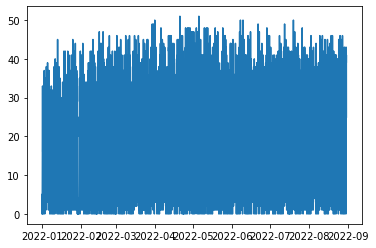

In [24]:
plt.plot(df['dep_eff_comp']) ## Example : Date time is working

In [23]:
## EDA

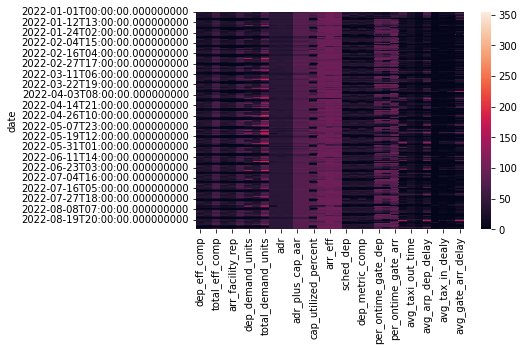

In [25]:
### Seeing correlations
df_numerical=df.drop(['runway','weather'], axis=1)
sns.heatmap(df_numerical)

In [26]:
df.corr()

,dep_eff_comp,arr_eff_comp,total_eff_comp,dep_facility_rep,arr_facility_rep,total_facility_rep,dep_demand_units,arr_demand_units,total_demand_units,eff_aar,...,per_ontime_arp_dep,per_ontime_gate_arr,avg_gate_dep_delay,avg_taxi_out_time,avg_taxi_out_delay,avg_arp_dep_delay,avg_airborn_delay,avg_tax_in_dealy,avg_block_delay,avg_gate_arr_delay
dep_eff_comp,1.000000,0.758646,0.944734,0.944068,0.765455,0.891424,0.801592,0.510329,0.757089,0.305030,...,-0.058894,-0.008974,0.116487,0.138394,0.121946,0.132898,0.062139,0.135141,0.099294,0.079115
arr_eff_comp,0.758646,1.000000,0.930306,0.747085,0.929087,0.870256,0.596118,0.702656,0.746273,0.346845,...,-0.093666,-0.027280,0.151743,0.158845,0.148614,0.170572,0.077199,0.180863,0.129155,0.099858
total_eff_comp,0.944734,0.930306,1.000000,0.907428,0.898456,0.939770,0.751250,0.640884,0.801754,0.346259,...,-0.080289,-0.018780,0.141937,0.157845,0.143436,0.160652,0.073830,0.167093,0.120892,0.094789
dep_facility_rep,0.944068,0.747085,0.907428,1.000000,0.846626,0.962498,0.773279,0.517454,0.744611,0.283300,...,-0.066444,-0.001429,0.116585,0.136631,0.120257,0.133019,0.059405,0.135250,0.099124,0.083201
arr_facility_rep,0.765455,0.929087,0.898456,0.846626,1.000000,0.959253,0.617644,0.667842,0.739090,0.309062,...,-0.102621,-0.022325,0.145989,0.149974,0.140420,0.163981,0.072873,0.173005,0.126207,0.102615
total_facility_rep,0.891424,0.870256,0.939770,0.962498,0.959253,1.000000,0.725400,0.615168,0.772089,0.307958,...,-0.087589,-0.012139,0.136317,0.148992,0.135428,0.154214,0.068687,0.159999,0.116963,0.096482
dep_demand_units,0.801592,0.596118,0.751250,0.773279,0.617644,0.725400,1.000000,0.510774,0.873102,0.115501,...,-0.102802,-0.068528,0.134991,0.116873,0.115537,0.148218,0.051959,0.160796,0.118609,0.101980
arr_demand_units,0.510329,0.702656,0.640884,0.517454,0.667842,0.615168,0.510774,1.000000,0.865101,0.007301,...,-0.129294,-0.107848,0.186196,0.113707,0.111315,0.191195,0.086599,0.207955,0.161973,0.152245
total_demand_units,0.757089,0.746273,0.801754,0.744611,0.739090,0.772089,0.873102,0.865101,1.000000,0.071529,...,-0.133301,-0.101142,0.184350,0.132672,0.130535,0.194902,0.079425,0.211746,0.161056,0.145837
eff_aar,0.305030,0.346845,0.346259,0.283300,0.309062,0.307958,0.115501,0.007301,0.071529,1.000000,...,0.020710,0.070816,0.001405,0.083678,0.077856,0.022322,0.033036,0.014741,0.019606,-0.006437


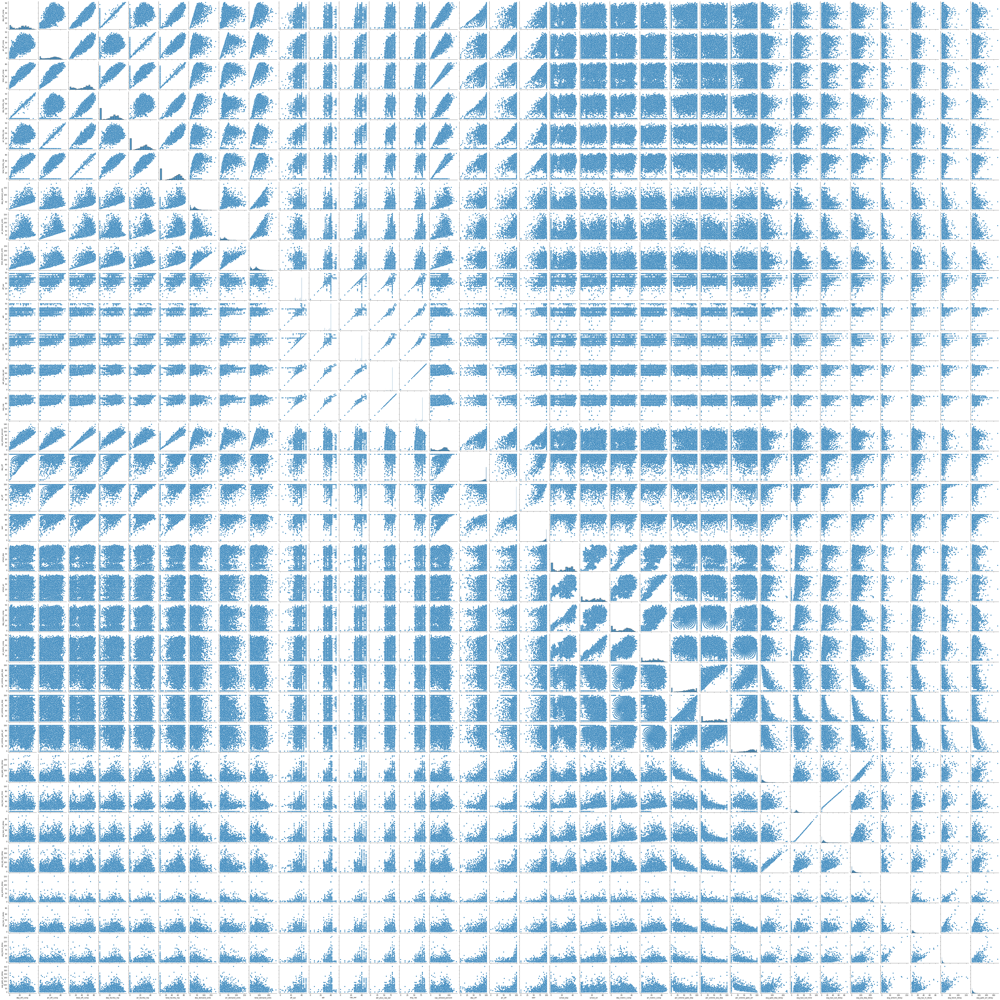

In [26]:
sns.pairplot(df)

In [27]:
pd.autocorrelation_plot(df['']) ## Variable that have correlations from heatmap

AttributeError: ignored

In [ ]:
## Univariate Analysis

## Bivariate Analysis


In [ ]:
## TEST


In [2]:
for i in range(len(df)):
  for j in range(37):
    if df[i][j].str.contains(',') == True:
      print(i,j)
  

NameError: ignored

AttributeError: ignored